# DSCI 100 09 Group 04 Project Report

Jessica Chi, Howard Liu, Fatima Rasool, Ruiwen Yang

### Introduction

"The HTRU2 dataset consists of pulsar candidates from the High Time Resolution Universe Survey (South)." Pulsars are a type of Neutron star that rotate rapidly and emit radio signals. Their unique radio emission patterns hold scientific significance and require labeling individualistic pulsar candidates into two classes: 0 (Negative/Spurious) and 1 (Positive/Real Pulsar).

With this dataset, we want to determine the relationship between the transmitted radio waves of pulsar stars, visualize the strong relationships between variables, and eventually create a KNN classification model to help classify new incoming observations based off of the current dataset as a training set. More specifically, we want to visualize and observe how the **skewness** and **kurtosis** can determine the class of a pulsar star.

### Methods

In our data analysis, we want to visualize and investigate the relationship between the integrated profiles for *skewness* and *kurtosis* of pulsar stars. Through this investigation, we will create a classification model that will classify the pulsar stars based on given observations.

The general process to work towards our goal is to start with loading and wrangling the data for quick and easy discernment and comprehension of the observations we are dealing with.

In [1]:
library(tidyverse) 
library(repr)
library(tidymodels)
install.packages("kknn")
set.seed(1000904)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.2     ✔ purrr   1.0.1
✔ tibble  3.2.1     ✔ dplyr   1.1.1
✔ tidyr   1.3.0     ✔ stringr 1.5.0
✔ readr   2.1.3     ✔ forcats 0.5.2
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
── Attaching packages ────────────────────────────────────── tidymodels 1.0.0 ──

✔ broom        1.0.2     ✔ rsample      1.1.1
✔ dials        1.1.0     ✔ tune         1.0.1
✔ infer        1.0.4     ✔ workflows    1.1.2
✔ modeldata    1.0.1     ✔ workflowsets 1.0.0
✔ parsnip      1.0.3     ✔ yardstick    1.1.0
✔ recipes      1.0.4     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filter()   masks stats::filter()
✖ recipes::fixed()  masks stringr::fixed()
✖ dplyr::lag()      masks stats::lag()
✖ yardstick::spec() masks read

#### Step 1: Loading Data

Load the data set from the web. In this case, we downloaded the data set from the web and added it to a github repository and loaded the *.csv* file from there. Prior to this report, in our proposal, we had wrangled our data to look more tidy. We also used the *glimpse()* function to view how many rows exist in the dataset.

In [2]:
pulsar_data <- read_csv("https://raw.githubusercontent.com/jesquachi/dsci-100-09-group-04-project/main/HTRU_2.csv", 
                         col_names = FALSE) |>   #reading data into rand giving the column readable names
                            rename(Mean_IP = X1,
                                   SD_IP = X2,
                                   Kurtosis_IP = X3,
                                   Skewness_IP = X4,
                                   Mean_DM_SNR = X5,
                                   SD_DM_SNR = X6,
                                   Kurtosis_DM_SNR = X7,
                                   Skewness_DM_SNR = X8,
                                   Class = X9) |>
                            mutate(Class = as_factor(Class)) |>
                            mutate(Class = fct_recode(Class, "Spurious" = "0", "Real Pulsar" = "1"))
glimpse(pulsar_data)

Rows: 17898 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (9): X1, X2, X3, X4, X5, X6, X7, X8, X9

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Rows: 17,898
Columns: 9
$ Mean_IP         <dbl> 140.56250, 102.50781, 103.01562, 136.75000, 88.72656, …
$ SD_IP           <dbl> 55.68378, 58.88243, 39.34165, 57.17845, 40.67223, 46.6…
$ Kurtosis_IP     <dbl> -0.23457141, 0.46531815, 0.32332837, -0.06841464, 0.60…
$ Skewness_IP     <dbl> -0.69964840, -0.51508791, 1.05116443, -0.63623837, 1.1…
$ Mean_DM_SNR     <dbl> 3.1998328, 1.6772575, 3.1212375, 3.6429766, 1.1789298,…
$ SD_DM_SNR       <dbl> 19.110426, 14.860146, 21.744669, 20.959280, 11.468720,…
$ Kurtosis_DM_SNR <dbl> 7.975532, 10.576487, 7.735822, 6.896499, 14.269573, 10…
$ Skewness_DM_SNR <dbl> 74.24222, 127.39358, 63.17191, 53.59366, 252.56731, 13…
$ Class           <fct> Spurious, Spurious, Spurious, Spurious, Spurious, Spur…


#### Step 2: Summarizing Data and Creating Training set Summaries

First, we made a table looking at the distinct classes and the percentage of observations in each class. Then we dropped any values and we started to split our data set into training and testing. With the newly split training set, we make another table looking at the classes of our training set and the percentage of observations in each class within our new training data set.

In [3]:
obs <- nrow(pulsar_data)
pulsar_data |>
  group_by(Class) |>
  summarize(
    count = n(),
    percentage = n() / obs * 100) 

Class,count,percentage
<fct>,<int>,<dbl>
Spurious,16259,90.842552
Real Pulsar,1639,9.157448


In [4]:
pulsar_split <- initial_split(pulsar_data, prop = 0.75, strata = Class)
pulsar_train <- training(pulsar_split)
pulsar_test <- testing(pulsar_split)
glimpse(pulsar_train)
glimpse(pulsar_test)

Rows: 13,423
Columns: 9
$ Mean_IP         <dbl> 140.56250, 102.50781, 103.01562, 136.75000, 88.72656, …
$ SD_IP           <dbl> 55.68378, 58.88243, 39.34165, 57.17845, 40.67223, 46.6…
$ Kurtosis_IP     <dbl> -0.234571412, 0.465318154, 0.323328365, -0.068414638, …
$ Skewness_IP     <dbl> -0.69964840, -0.51508791, 1.05116443, -0.63623837, 1.1…
$ Mean_DM_SNR     <dbl> 3.199833, 1.677258, 3.121237, 3.642977, 1.178930, 1.63…
$ SD_DM_SNR       <dbl> 19.11043, 14.86015, 21.74467, 20.95928, 11.46872, 14.5…
$ Kurtosis_DM_SNR <dbl> 7.975532, 10.576487, 7.735822, 6.896499, 14.269573, 10…
$ Skewness_DM_SNR <dbl> 74.24222, 127.39358, 63.17191, 53.59366, 252.56731, 13…
$ Class           <fct> Spurious, Spurious, Spurious, Spurious, Spurious, Spur…
Rows: 4,475
Columns: 9
$ Mean_IP         <dbl> 119.48438, 138.17969, 99.91406, 128.34375, 142.05469, …
$ SD_IP           <dbl> 48.76506, 51.52448, 43.91950, 52.17211, 53.87316, 47.6…
$ Kurtosis_IP     <dbl> 0.03146022, -0.03185233, 0.47572850, -0.04928040,

In [5]:
obs_train <- nrow(pulsar_train)
pulsar_train |>
  group_by(Class) |>
  summarize(
    count = n(),
    percentage = n() / obs_train * 100)

Class,count,percentage
<fct>,<int>,<dbl>
Spurious,12190,90.814274
Real Pulsar,1233,9.185726


We also viewed the mean of every variable.

In [6]:
pulsar_mean <- pulsar_train |>
                    select(Mean_IP:Skewness_DM_SNR) |>
                    map_dfr(mean)
pulsar_mean

Mean_IP,SD_IP,Kurtosis_IP,Skewness_IP,Mean_DM_SNR,SD_DM_SNR,Kurtosis_DM_SNR,Skewness_DM_SNR
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
111.0766,46.53841,0.4781927,1.76726,12.42404,26.28258,8.314695,105.1183


#### Step 3: Preliminary Analysis

We continued to explore the different relationships between each variable, and eventually came to the conclusion that the ideal predictors for this classification model would be between the skewness and kurtosis data obtained from observations. As seen below, we created two graphs visualizing the relationships between skewness and kurtosis of both the integrated profiles and DM-SNR. After we visualized the relationships of the integrated profile and DM-SNR aspects of these two variables, we came to the conclusion that the data from the integrated profile had the stronger relationship.

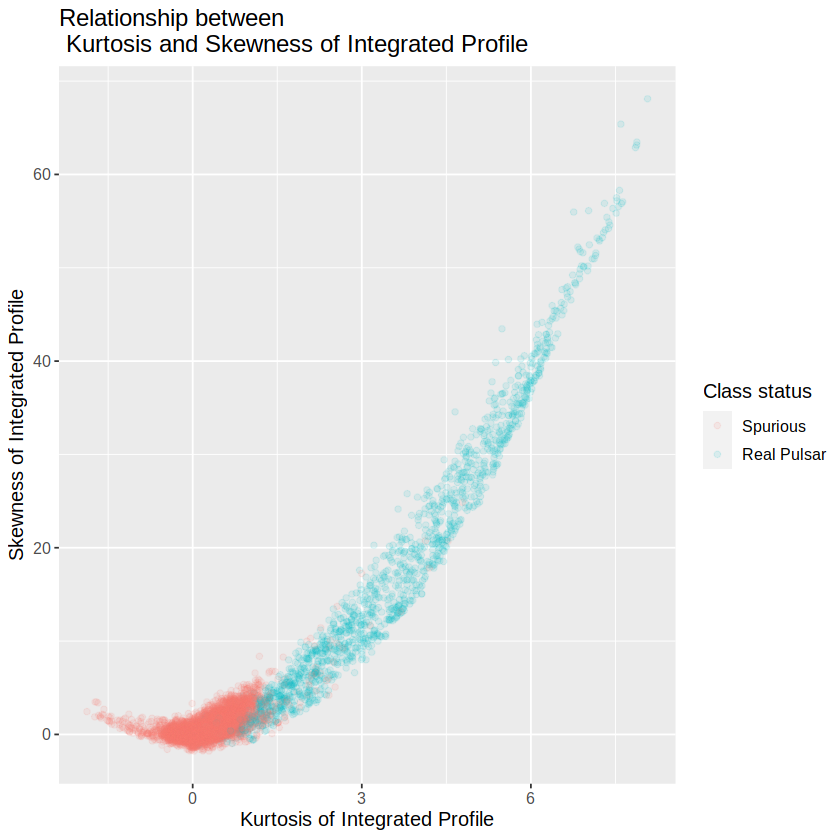

In [7]:
Kurtosis_IP_Skewness_IP <- pulsar_data |>
  ggplot(aes(x = Kurtosis_IP, y = Skewness_IP, color = Class)) +
  geom_point(alpha = 0.1) +
  labs(x = "Kurtosis of Integrated Profile", 
       y = "Skewness of Integrated Profile", 
       color = "Class status",
       title = "Relationship between \n Kurtosis and Skewness of Integrated Profile") +
  theme(text = element_text(size = 12))
Kurtosis_IP_Skewness_IP 

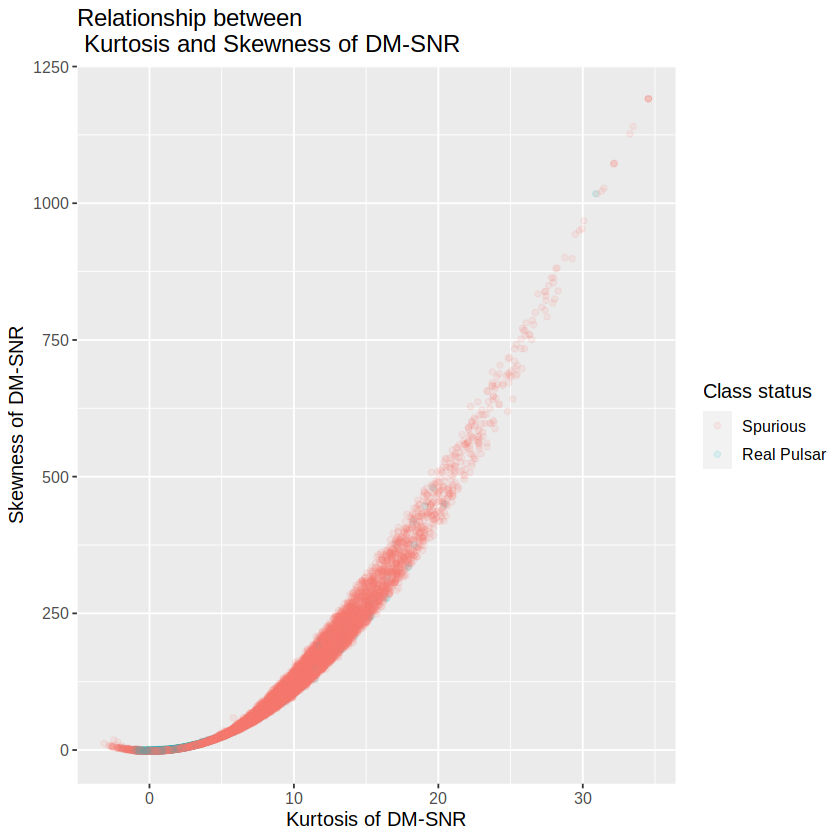

In [8]:
Kurtosis_Skewness_DM_SNR <- pulsar_data |>
  ggplot(aes(x = Kurtosis_DM_SNR, y = Skewness_DM_SNR, color = Class)) +
  geom_point(alpha = 0.1) +
  labs(x = "Kurtosis of DM-SNR", 
       y = "Skewness of DM-SNR", 
       color = "Class status",
       title = "Relationship between \n Kurtosis and Skewness of DM-SNR") +
  theme(text = element_text(size = 12))
Kurtosis_Skewness_DM_SNR

#### Step 4: Data Analysis - Finding Optimal K

Before we start creating a classification model, we want to find the optimal K value for our K-Nearest-Neighbor (KNN) algorithm to follow. In order to do this, we have to further split our training set from above into a training subset and validation subset. We are creating these distributions to make cross-validation folds. After splitting our validation sets, the next steps to finding an ideal K value include: creating a recipe, standardizing the predictors, creating a KNN spec with *tune_grid*, utilizing the *vfold_cv* function to create folds, creating tibble for grid values, and lastly putting everything (the recipe, spec, vfold, and grid values) into a workflow. Finally, we can create a plot that displays the K number of folds and their corresponding accuracy. From the graph, we can see that the most optimal *K* value is ***K* = 11**, with an accuracy percentage of around *97.80%*.

In [9]:
pulsar_train_split <- initial_split(pulsar_train, prop = 0.75, strata = Class)
pulsar_subtrain <- training(pulsar_train_split)
pulsar_validation <- testing(pulsar_train_split)

In [10]:
pulsar_subtrain_recipe <- recipe(Class ~ Skewness_IP + Kurtosis_IP, data = pulsar_subtrain) |>
                step_scale(all_predictors()) |>
                step_center(all_predictors())

In [11]:
pulsar_optimalk_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
                     set_engine("kknn") |>
                     set_mode("classification")

In [12]:
pulsar_vfold <- vfold_cv(pulsar_subtrain, v = 5, strata = Class)
grid_values <- tibble(neighbors = seq(from = 1, to = 15, by = 1))

In [13]:
pulsar_vfoldfit <- workflow() |>
             add_recipe(pulsar_subtrain_recipe) |>
             add_model(pulsar_optimalk_spec) |>
             tune_grid(resamples = pulsar_vfold, grid = grid_values) |>
             collect_metrics()

pulsar_accuracies <- pulsar_vfoldfit |>
                         filter(.metric == "accuracy") 

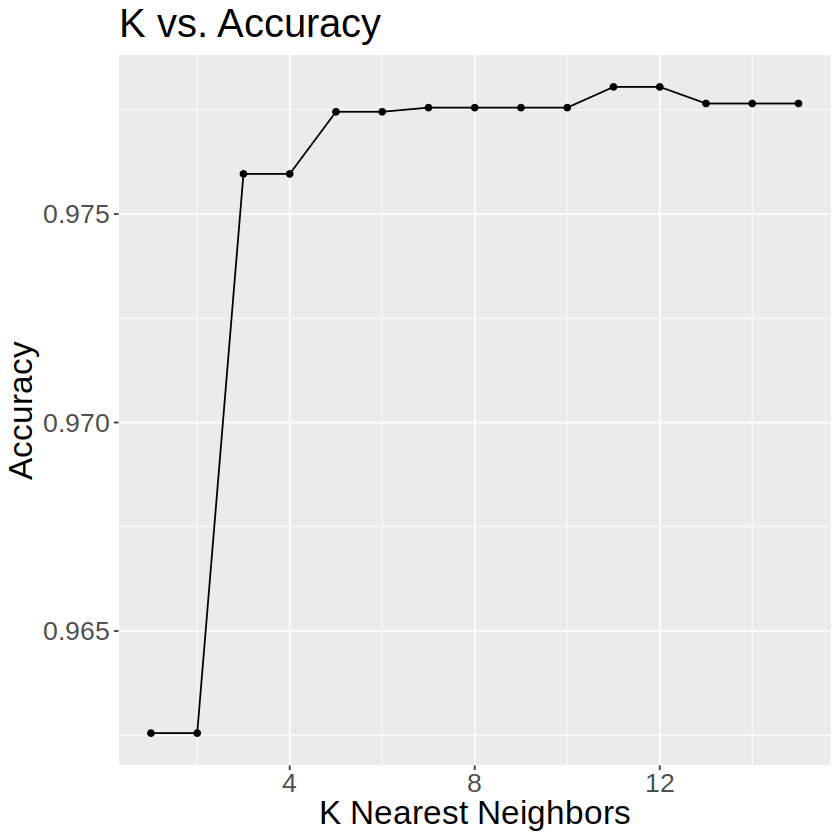

In [14]:
cross_val_plot <- ggplot(pulsar_accuracies, aes(x = neighbors, y = mean)) +
                     geom_point() +
                     geom_line() +
                   labs(title = "K vs. Accuracy",
                        x = "K Nearest Neighbors",
                        y = "Accuracy") +
                   theme(text = element_text(size = 20))
cross_val_plot

#### Step 5: Building Classification Model

After finding the optimal K-value above through cross-validation folding, we can now create an ideal KNN model using the value found on the peak of the graph above. To do this, we need to create a new recipe (basing it off of our training set instead of our subtraining set) and new spec model (replacing *tune()* with the optimal K-value found above, which equals 11).

In [22]:
pulsar_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 11) |>
  set_engine("kknn") |>
  set_mode("classification")

pulsar_recipe <- recipe(Class ~ Skewness_IP + Kurtosis_IP, data = pulsar_train) |>
                    step_scale(all_predictors()) |>
                    step_center(all_predictors())

pulsar_fit <- workflow() |>
                add_recipe(pulsar_recipe) |>
                add_model(pulsar_spec) |>
                fit(data = pulsar_train)
pulsar_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
2 Recipe Steps

• step_scale()
• step_center()

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(11,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.02093422
Best kernel: rectangular
Best k: 11

#### Evaluating Performance

Now, we looked at the accuracy of our models with both tidyverse calculations and a confusion matrix. The first table below shows the accuracy of our model, whereas the confusion matrix allows us to calculate precision and recall along with accuracy.

Our metric table corresponds closely to the accuracy of our optimal K found above, as seen on our 'Accuracy Vs. K Nearest Neighbor' graph

More specifically, based on our confusion matrix, the KNN classification model has the:

Precision of

Recall of

In [28]:
pulsar_predictions <- predict(pulsar_fit, pulsar_test) |>
                        bind_cols(pulsar_test)

pulsar_metrics <- pulsar_predictions |>
                    metrics(truth = Class, estimate = .pred_class) |>
                    filter(.metric == "accuracy")
pulsar_metrics

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.9767598


In [29]:
pulsar_conf_mat <- pulsar_predictions |>
    conf_mat(truth = Class, estimate = .pred_class)
pulsar_conf_mat

             Truth
Prediction    Spurious Real Pulsar
  Spurious        4041          76
  Real Pulsar       28         330

#### Step 6: Visualization of Classification Model

After we have successfully created our KNN classification model, we can create a coloured prediction map for our KNN model of K = 11.

In [30]:
kurt_grid <- seq(min(pulsar_data$Kurtosis_IP), 
                max(pulsar_data$Kurtosis_IP), 
                length.out = 100)
skew_grid <- seq(min(pulsar_data$Skewness_IP), 
                max(pulsar_data$Skewness_IP), 
                length.out = 100)
asgrid <- as_tibble(expand.grid(Kurtosis_IP = kurt_grid, 
                                Skewness_IP = skew_grid))

In [33]:
knnPredGrid <- predict(pulsar_fit, asgrid)
prediction_table <- bind_cols(knnPredGrid, asgrid) |> 
  rename(Class = .pred_class)

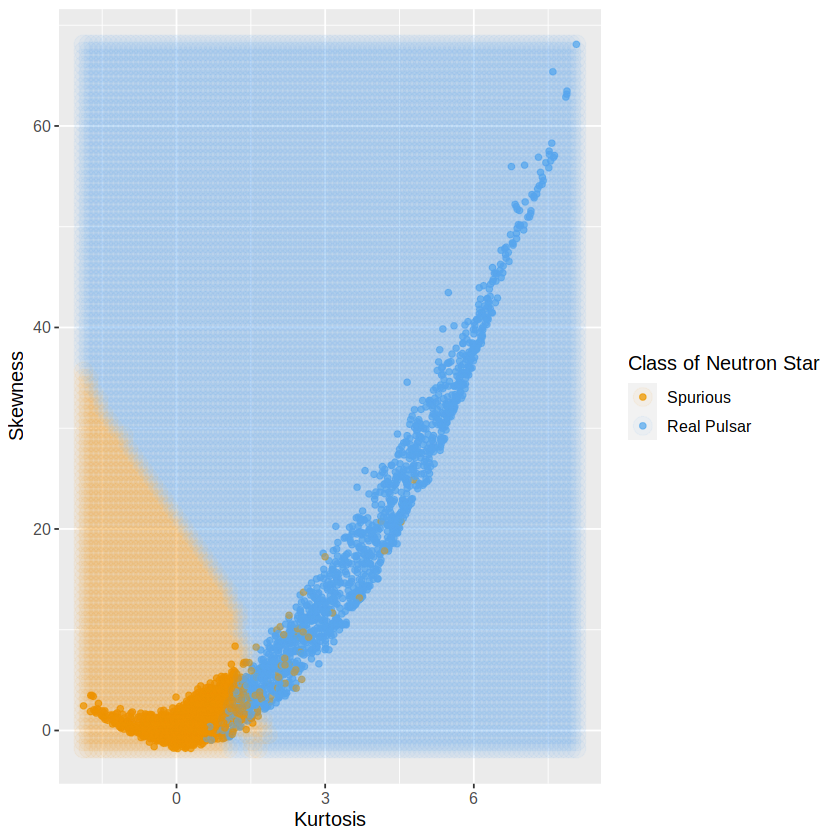

In [36]:
wkflw_plot <- ggplot() +
                geom_point(data = pulsar_data, 
                    mapping = aes(x = Kurtosis_IP, 
                                  y = Skewness_IP, 
                                  color = Class), 
                    alpha = 0.75) +
                geom_point(data = prediction_table, 
                    mapping = aes(x = Kurtosis_IP, 
                                  y = Skewness_IP, 
                                  color = Class), 
                    alpha = 0.05, 
                    size = 5) +
                labs(color = "Class of Neutron Star", 
                     x = "Kurtosis", 
                     y = "Skewness") +
                scale_color_manual(values = c("orange2", "steelblue2")) +
                theme(text = element_text(size = 12))
wkflw_plot

### Summary

#### Findings:

### Citations/Sources

Lyon,Robert. (2017). HTRU2. UCI Machine Learning Repository. https://doi.org/10.24432/C5DK6R.

Shaw, B. S. (2021, September 30). Predicting pulsar stars: An imbalanced classification task comparing Bootstrap Resampling to smote. Medium. https://towardsdatascience.com/predicting-pulsar-stars-an-imbalanced-classification-task-comparing-bootstrap-resampling-to-smote-8cfbe037b807 

Lea, R. (2016, April 22). What are pulsars?. Space.com. https://www.space.com/32661-pulsars.html 